In [1]:
from boututils.datafile import DataFile
from boutdata.collect import collect
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os, sys, pathlib
import platform
import traceback
import xarray as xr
import xbout
from pathlib import Path
import xhermes as xh
import matplotlib.pyplot as plt
import os, sys, pathlib
import numpy as np
import xarray as xr
import xhermes as xh

sys.path.append(os.path.join(r"/users/jlb647/scratch/simulation_program/hermes-3_sim/analysis/sdtools"))
sys.path.append(os.path.join(r"/users/jlb647/scratch/simulation_program/hermes-3_sim/analysis/my_notebooks/notebooks/hermes-3/general_functions"))

from convergence_functions import *

from matplotlib.ticker import LogFormatter

sys.path.append(os.path.join(r"/users/jlb647/scratch/simulation_program/hermes-3_sim/analysis/sdtools"))
sys.path.append(os.path.join(r"/users/jlb647/scratch/simulation_program/hermes-3_sim/analysis/my_notebooks/notebooks/hermes-3/transients"))
sys.path.append(os.path.join(r"/users/jlb647/scratch/simulation_program/hermes-3_sim/analysis/my_notebooks/notebooks/hermes-3/general_functions"))


from plotting_functions import *
from convergence_functions import * 

from hermes3.case_db import *
from hermes3.load import *
from hermes3.named_selections import *
from hermes3.plotting import *
from hermes3.grid_fields import *
from hermes3.accessors import *
from hermes3.utils import *
from hermes3.fluxes import *


# plt.style.use('ggplot')
plt.rcParams.update({'font.size': 10})
linewidth = 3
markersize = 15



# plt.style.use('ggplot')
plt.style.use('default')
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams["axes.linewidth"] = 1
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams['axes.grid'] = True
plt.rcParams.update({'font.size': 16})



%load_ext autoreload
%autoreload 2


# 1e21 pump

In [2]:
ds = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-10_glimmer_pump_test/reservior_test/case_10_pump_1e22_pump')

In [3]:
def plot_time_history(dataset, variables=['Te'], upstream_index=2, target_index=-2,
                      track_detachment_front=False, time_slices=800,
                      log_threshold=1e6, base_figsize=(6, 4)):
    """
    Plots the time history of user-specified variables at upstream and target positions
    on separate plots, using the last 200 time slices or the maximum available.

    Optionally tracks the detachment front, where Nd > Ne, and adds it as a separate subplot.

    Parameters:
    dataset (xarray Dataset): Hermes-3 dataset.
    variables (list): List of variables to plot (e.g., ['Te', 'Td+', 'Ne']).
    upstream_index (int): Index for the upstream data.
    target_index (int): Index for the target data.
    track_detachment_front (bool): If True, track the location where Nd > Ne
                                   and show it as a separate subplot.
    log_threshold (float): Threshold above which the y-axis will be plotted in log scale.
    base_figsize (tuple): Base figure size for a single plot (width, height).
    """
    # Determine how many time steps to plot (maximum 200 or the total available)
    num_time_slices = min(time_slices, dataset.sizes['t'])

    # Select the last `num_time_slices` time steps
    selected_steps = dataset.isel(t=slice(-num_time_slices, None))
    times = selected_steps['t'].values 
    t_conversion = dataset['t'].attrs.get('conversion', 1.0)
    # times = times * t_conversion  
    times = times * 1e3  # Convert to milliseconds for plotting

    # Find the last time step in milliseconds
    last_time_step = times[-1]

    # Adjust the number of subplots based on whether we're tracking detachment front
    total_vars = len(variables) + (1 if track_detachment_front else 0)

    # Dynamically scale figure size based on number of variables
    figsize = (base_figsize[0] * total_vars, base_figsize[1] * 2)

    # Create figure with subplots, one set for upstream and one for target, plus detachment front if enabled
    fig, axs = plt.subplots(2, total_vars, figsize=figsize, dpi=500)

    # Ensure axs is treated as a list if there's only one plot
    if total_vars == 1:
        axs = [axs[0], axs[1]]

    axs = np.ravel(axs)  # Flatten the axes for easy handling

    # Variable to store positions where Nd > Ne (detachment front)
    detachment_front_positions = [] if track_detachment_front else None

    # If tracking the detachment front, calculate it for each time slice
    if track_detachment_front:
        front_positions = []
        for t_step in range(num_time_slices):
            ds_at_t = selected_steps.isel(t=t_step)
            front_loc = detachment_front_finder(ds_at_t)
            front_positions.append(front_loc)
        detachment_front_positions = np.array(front_positions)

    # Iterate over each variable to plot upstream and target values
    for i, var in enumerate(variables):
        # Extract upstream and target data for each variable
        upstream_data = np.squeeze(selected_steps[var].isel(y=upstream_index).values)
        target_data = np.squeeze(selected_steps[var].isel(y=target_index).values)

        # Check if data exceeds the threshold, and use log scale if so
        if np.max(np.abs(upstream_data)) > log_threshold or np.max(np.abs(target_data)) > log_threshold:
            scale = "log"
        else:
            scale = "linear"

        # Plot upstream data on the top row
        axs[i].plot(times, upstream_data, label=f'Upstream {var}', marker='o', linestyle='-')
        axs[i].set_title(f'Upstream {var}')
        axs[i].set_xlabel('Time (ms)')
        axs[i].set_ylabel(f'{var} ({dataset[var].attrs.get("units", "Unknown units")})')
        axs[i].grid(True)
        axs[i].set_yscale(scale)

        # Apply custom log formatter for log scale
        if scale == "log":
            axs[i].yaxis.set_major_formatter(log_formatter())

        # Plot target data on the bottom row
        axs[i + total_vars].plot(times, target_data, label=f'Target {var}', marker='x', linestyle='--')
        axs[i + total_vars].set_title(f'Target {var}')
        axs[i + total_vars].set_xlabel('Time (ms)')
        axs[i + total_vars].set_ylabel(f'{var} ({dataset[var].attrs.get("units", "Unknown units")})')
        axs[i + total_vars].grid(True)
        axs[i + total_vars].set_yscale(scale)

        # Apply custom log formatter for target plot
        if scale == "log":
            axs[i + total_vars].yaxis.set_major_formatter(log_formatter())

    # Add a separate subplot for the detachment front position if requested
    if track_detachment_front:
        detachment_front_index = len(variables)  # The next index after all variables
        axs[detachment_front_index].plot(times, detachment_front_positions, marker='s', linestyle='-', color='red',
                                         label='Nd > Ne Front')
        axs[detachment_front_index].set_title('Detachment Front Position (Nd > Ne)')
        axs[detachment_front_index].set_xlabel('Time (ms)')
        axs[detachment_front_index].set_ylabel('Position (m)')
        axs[detachment_front_index].grid(True)

        # Plot the same on the bottom row
        axs[detachment_front_index + total_vars].plot(times, detachment_front_positions, marker='s', linestyle='-', color='red',
                                                      label='Nd > Ne Front')
        axs[detachment_front_index + total_vars].set_title('Detachment Front Position (Nd > Ne)')
        axs[detachment_front_index + total_vars].set_xlabel('Time (ms)')
        axs[detachment_front_index + total_vars].set_ylabel('Position (m)')
        axs[detachment_front_index + total_vars].grid(True)

    # Set the figure's overall title with the time of the last time step
    plt.suptitle(f"Time History of Variables (Last time step: {last_time_step:.8f} (ms) / {last_time_step*1e-3:.8f}(s)", fontsize=16)

    plt.tight_layout()


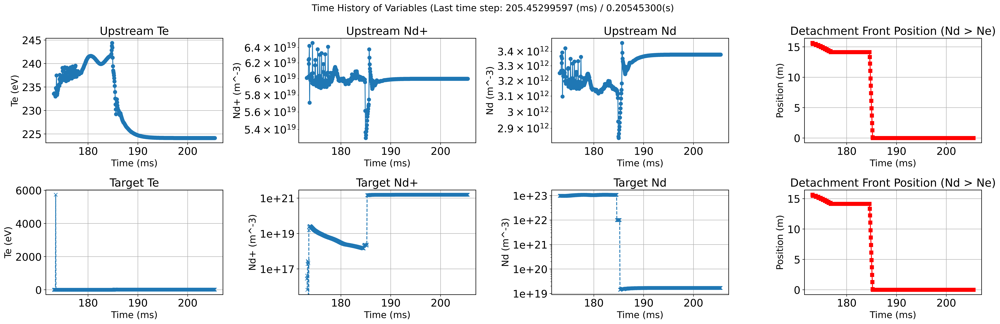

In [4]:
plot_time_history(ds, variables = ['Te','Nd+', 'Nd'], track_detachment_front=True)

array([<Axes: xlabel='S$_\\parallel$ (m)', ylabel='Te (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Nd (m^-3)'>],
      dtype=object)

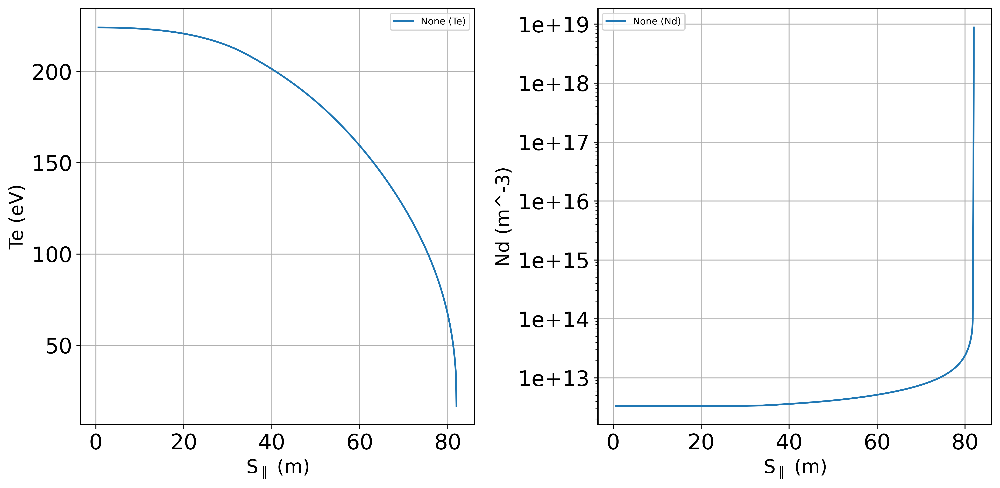

In [5]:
plot_profiles(ds, variables = ['Te', 'Nd'])

In [17]:

for var_name, data_array in ds.data_vars.items():
    print(f"Variable: {var_name}")
    print(data_array)
    print("\n")  # Add a new line for better readability
    
    # print(f"Dimensions: {data_array.dims}")
    # print(f"Coordinates: {list(data_array.coords)}")
    # print(f"Attributes: {data_array.attrs}")
    # print("\n")  # Add a new line for better readability

Variable: Bxy
<xarray.DataArray 'Bxy' (x: 1, y: 400)>
dask.array<concatenate, shape=(1, 400), dtype=float64, chunksize=(1, 10), chunktype=numpy.ndarray>
Coordinates:
    dx       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
    dy       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
    dz       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
  * x        (x) int64 0
  * y        (y) float64 0.1945 0.5831 0.9708 1.357 ... 81.92 81.95 81.97 81.99
Attributes:
    cell_location:  CELL_CENTRE
    direction_y:    Standard
    direction_z:    Average
    source:         Coordinates
    metadata:       {'BOUT_VERSION': 5.2, 'Bnorm': 1.0, 'Cs0': 97871.51425755...
    options:        IncIntShear = false\t\t# type: bool, source: default\nMXG...
    geometry:       


Variable: Ed+_iz
<xarray.DataArray 'Ed+_iz' (t: 620, x: 1, y: 400, z: 1)>
dask.array<mul, shape=(620, 1, 400, 1), dtype=float64, chunksize=(620, 1, 10, 1), chunktype=numpy.ndarray>
Coord

In [20]:
deuterium_sources = [
    "SNd", "Sd_rsv_div_pfr", "Sd_rsv_div_sol", "Sd_rsv_main_sol", "Sd_src",
    "Sd_target_recycle"
]
deuterium_ion_sources = [
    "SNd+", "density_feedback_src_i_d+", "density_feedback_src_mult_d+",
    "Sd+_feedback", "Sd+_iz", "Sd+_rec", "Sd+_src"
    ]


def particle_sink_source(ds, sources, sinks, variable=None, log_scale=False):
    """
    Plots the individual particle sources and sinks over time and calculates
    the net balance as total sources minus total sinks, or source - sink
    if log_scale is True. Sources are plotted as solid lines, and sinks as
    dashed lines (made positive if log_scale is True).

    Parameters:
    ds (xarray.Dataset): The dataset containing particle source and sink variables.
    sources (list): List of variable names for sources.
    sinks (list): List of variable names for sinks.
    variable (str, optional): An additional variable to plot.
    log_scale (bool): If True, plots the y-axis on a logarithmic scale and
                      source/sink terms are made positive, with total defined
                      as source - sink.
    """
    # Dictionary to store results for each variable
    data_dict = {}

    # Calculate the y intervals for non-uniform spacing
    y = ds['y'].values
    # Extend dy to match the length of y by adding the last interval
    dy = np.concatenate([np.diff(y), [y[-1] - y[-2]]])

    # Calculate the total particles for sources by summing density * interval width
    for var in sources:
        if 't' in ds[var].dims:
            # Multiply density by interval width (dy) across the full range
            data_dict[var] = (abs(ds[var] * dy).sum(dim=[dim for dim in ds[var].dims if dim != 't']).values)
            print(f'{var} : {data_dict[var]}')
        else:
            data_dict[var] = (abs(ds[var] * dy).values.sum())

    # Calculate the total particles for sinks by summing density * interval width
    # Make sinks positive if log_scale is True
    for var in sinks:
        if 't' in ds[var].dims:
            value = (abs(ds[var] * dy).sum(dim=[dim for dim in ds[var].dims if dim != 't']).values)
            data_dict[var] = value if log_scale else -value
            print(f'{var} : {data_dict[var]}')
        else:
            value = (abs(ds[var] * dy).values.sum())
            data_dict[var] = value if log_scale else -value

    # Add an optional variable if provided
    if variable is not None:
        units = ds[variable].attrs.get('units', 'Unknown units')
        data_dict[variable] = (ds[variable]).sum(dim=[dim for dim in ds[variable].dims if dim != 't']).values

    # Convert dictionary to DataFrame, using the time values as the index
    df_d = pd.DataFrame(data_dict, index=(ds['t'].values * 1e3))  # Convert time to ms

    # Calculate the total source as source - sink if log_scale, otherwise source + sink
    total_sources = df_d[sources].sum(axis=1)
    total_sinks = df_d[sinks].sum(axis=1)
    if log_scale:
        df_d["Total Source - Sinks"] = total_sources - total_sinks
        print(f'Total Source - Sinks : {df_d["Total Source - Sinks"]}')
    else:
        df_d["Total Source - Sinks"] = total_sources + total_sinks
        print(f'Total Source + Sinks : {df_d["Total Source - Sinks"]}')

    # Plot each source and sink with specific line styles
    fig, ax = plt.subplots(1, 1, figsize=(12, 8), dpi=500)
    for column in df_d.columns:
        if column in sources:
            ax.plot(df_d.index, df_d[column], linestyle='-', label=column)  # Solid line for sources
        elif column in sinks:
            ax.plot(df_d.index, df_d[column], linestyle='--', label=column)  # Dashed line for sinks

    # Plot the net balance
    ax.plot(df_d.index, df_d["Total Source - Sinks"], linestyle='-', color='black', label='Total Source - Sinks')

    # Plot an additional variable if provided
    if variable is not None:
        ax_twin = ax.twinx()
        ax_twin.plot(df_d.index, df_d[variable], linestyle=':', color='black', label=f'{variable}')
        ax_twin.set_ylabel(f'Spatial Sum of {variable} ({units})')
        ax_twin.set_yscale('log' if log_scale else 'linear')

    # Set y-axis scale for the main plot
    if log_scale:
        ax.set_yscale("log")

    # Labels and legend
    ax.set_xlabel("Time (ms)")
    ax.set_ylabel("Particle Source/Sink (s^-1)")
    ax.grid(True)
    ax.legend(loc='best', fontsize=8)
    fig.show()


# Example usage with your dataset and specified neutral and ion sources
deuterium_sources = [
    "SNd", "Sd_rsv_div_pfr", "Sd_rsv_div_sol", "Sd_rsv_main_sol", "Sd_src",
    "Sd_target_recycle"
]
deuterium_ion_sources = [
    "SNd+", "density_feedback_src_i_d+", "density_feedback_src_mult_d+",
    "Sd+_feedback", "Sd+_iz", "Sd+_rec", "Sd+_src"
]

neutral_sources = ['Sd_src', 'Sd+_rec','Sd_target_recycle' ]
neutral_sinks = ['Sd_rsv_div_sol', 'Sd+_iz']


neutral_sources = [ 'Sd+_rec','Sd_target_recycle', 'Sd_src']
neutral_sinks = [ 'Sd+_iz',  'Sd_rsv_div_sol']


neutral_sources = [ 'Sd+_rec','Sd_target_recycle', 'Sd_src']
neutral_sinks = [ 'Sd+_iz',  'Sd_rsv_div_sol']

energy_sources = ['Rneon', 'Rd+_rec', 'Rd+_ex']

# particle_sink_source(ds, sources = [], sinks = energy_sources, log_scale = True)



850.7558167804849


ValueError: x and y must have same first dimension, but have shapes (400,) and (1,)

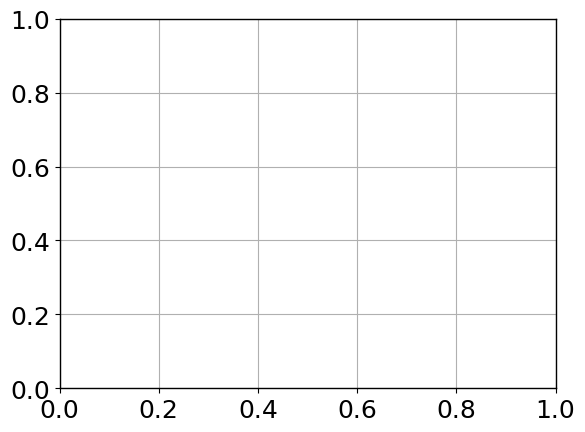

In [179]:

f_mult = ds['density_feedback_src_mult_d+'].isel(t= -1).values
print(f_mult)
y = ds['y']

plt.plot(y, f_mult)


# 7e22 pump

In [20]:
stepped_pump = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-11_week_8/steady_state_2D_density_pump/case_014_013_7e22_pump_longer_run')

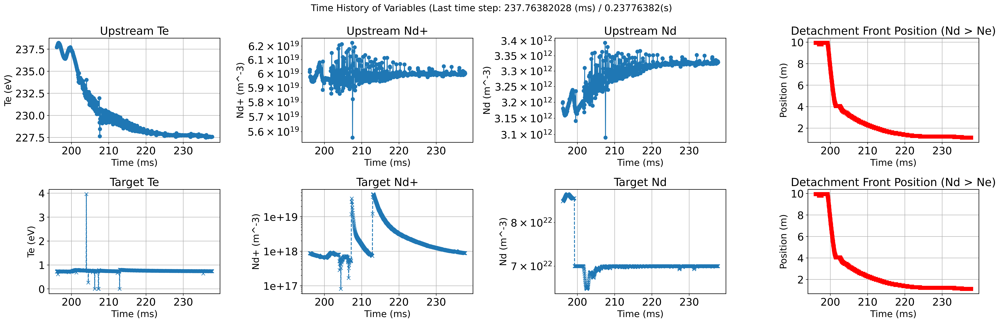

In [23]:
plot_time_history(stepped_pump, variables = ['Te','Nd+', 'Nd'], track_detachment_front=True)

In [19]:
neutral_sources = [ 'Sd+_rec','Sd_target_recycle', 'Sd_src']
neutral_sinks = [ 'Sd+_iz',  'Sd_rsv_div_sol', "Sd+_feedback"]


energy_sources = ['Rneon', 'Rd+_rec', 'Rd+_ex']
particle_sink_source(stepped_pump, sources = []], sinks = energy_sources, variable = 'Nd', log_scale=False)

SyntaxError: closing parenthesis ']' does not match opening parenthesis '(' (798086212.py, line 6)

In [64]:
deuterium_sources = [
        "SNd", "Sd_rsv_div_pfr", "Sd_rsv_div_sol", "Sd_rsv_main_sol", "Sd_src",
        "Sd_target_recycle"
    ]
deuterium_ion_sources = [
        "SNd+", "density_feedback_src_i_d+", "density_feedback_src_mult_d+",
        "Sd+_feedback", "Sd+_iz", "Sd+_rec", "Sd+_src"
    ]

all_sources = deuterium_sources + deuterium_ion_sources

for var in all_sources:
    print(ds[var])
    # print(ds[var].dims)
    # print(ds[var].values)
    print("\n")

# for var_name, data_array in ds.data_vars.items():
#     print(f"Variable: {var_name}")
    # print(f"Dimensions: {data_array.dims}")
    # print(f"Coordinates: {list(data_array.coords)}")
    # print(f"Attributes: {data_array.attrs}")
    # print("\n")  # Add a new line for better readability


<xarray.DataArray 'SNd' (t: 620, x: 1, y: 400, z: 1)>
dask.array<mul, shape=(620, 1, 400, 1), dtype=float64, chunksize=(620, 1, 10, 1), chunktype=numpy.ndarray>
Coordinates:
    dx       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
    dy       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
    dz       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
  * t        (t) float64 0.1731 0.1732 0.1732 0.1733 ... 0.2053 0.2054 0.2055
  * x        (x) int64 0
  * y        (y) float64 0.1945 0.5831 0.9708 1.357 ... 81.92 81.95 81.97 81.99
  * z        (z) float64 3.142
Attributes:
    current_time_index:  620
    cell_location:       CELL_CENTRE
    conversion:          9.578833303066081e+26
    direction_y:         Standard
    direction_z:         Standard
    long_name:           d total number density source
    source:              evolve_density
    species:             d
    standard_name:       total density source
    time_dimension:      t

In [16]:


plot_profiles_animation(ds, variables=['Te', 'Nd','Sd_rsv_div_sol'], time_slices=(-600, None),step=2)

Animation saved as profiles_animation.gif


In [17]:
convert_gif_to_mp4('profiles_animation.gif', 'output_04.mp4')

Moviepy - Building video output_04.mp4.
Moviepy - Writing video output_04.mp4



Moviepy - Done !
Moviepy - video ready output_04.mp4


# 1e21 sink source 

In [13]:
ds_sink_source = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-10_glimmer_pump_test/reservior_test/case_11_1e22_sink_source')

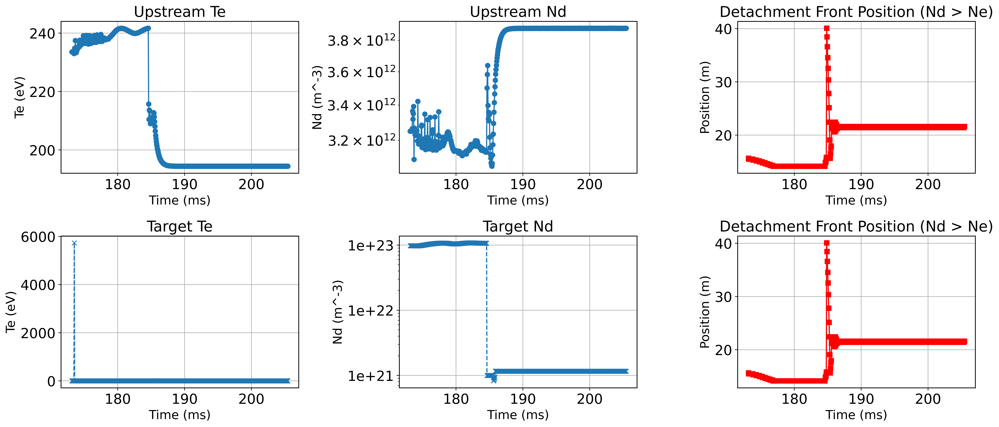

In [14]:
plot_time_history(ds_sink_source, variables=['Te','Nd'], track_detachment_front = True)

array([<Axes: xlabel='S$_\\parallel$ (m)', ylabel='Te (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Td+ (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Sd_rsv_div_sol (m^-3 s^-1)'>,
       <Axes: >], dtype=object)

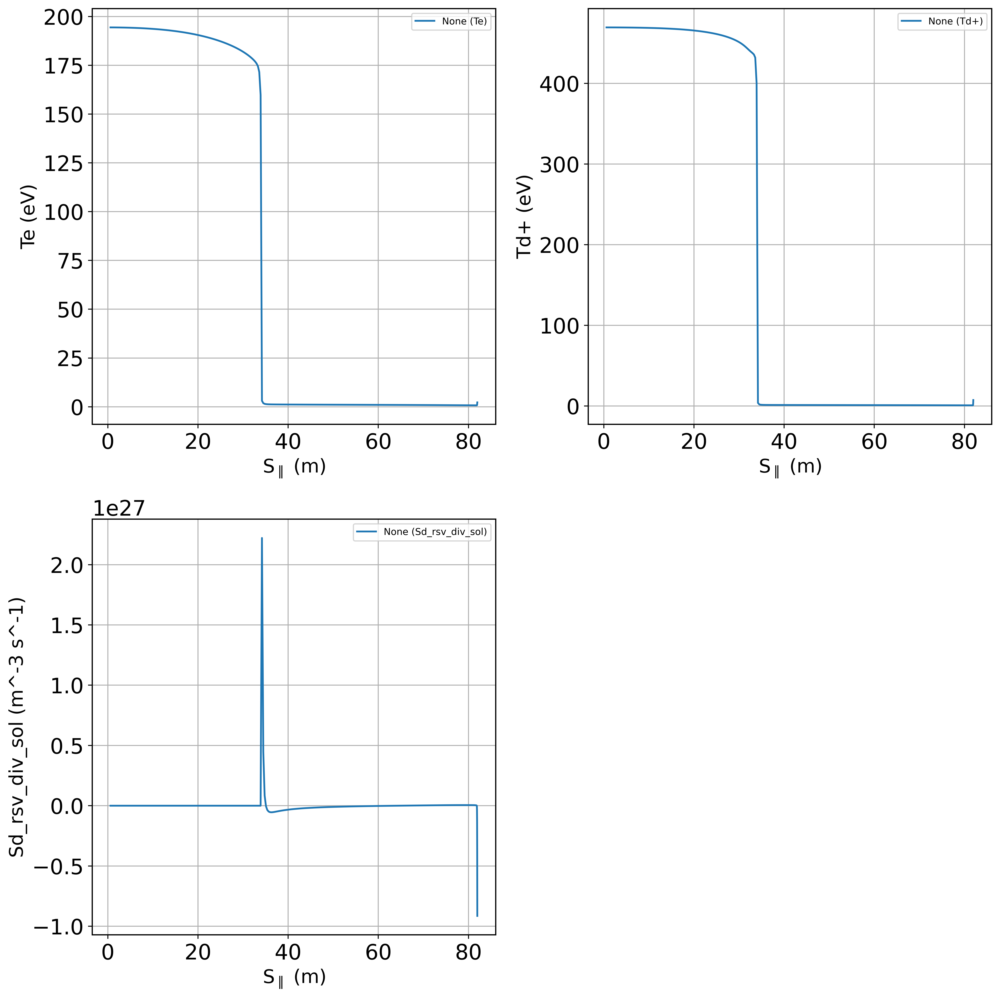

In [19]:
plot_profiles(ds_sink_source, variables = ['Te', 'Td+', 'Sd_rsv_div_sol'])

In [19]:
plot_profiles_animation(ds_sink_source, variables=['Te', 'Nd','Sd_rsv_div_sol'], time_slices=(-600, None),step=2)
convert_gif_to_mp4('profiles_animation.gif', 'output_source_sink.mp4')

Animation saved as profiles_animation.gif
Moviepy - Building video output_source_sink.mp4.
Moviepy - Writing video output_source_sink.mp4



Moviepy - Done !
Moviepy - video ready output_source_sink.mp4


# Fixed Density source


In [65]:
fixed_density = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-11_week_8/steady_state_fixed_density/case_02_start_from_base_01')

In [9]:
for var_name, data_array in fixed_density.data_vars.items():
    print(f"Variable: {var_name}")
    # print(f"Dimensions: {data_array.dims}")
    # print(f"Coordinates: {list(data_array.coords)}")
    # print(f"Attributes: {data_array.attrs}")
    # print("\n")  # Add a new line for better readability


Variable: Bxy
Variable: Ed+_iz
Variable: Ed+_rec
Variable: Ed+_sheath
Variable: Ed_target_recycle
Variable: Edd+_cx
Variable: Ee_sheath
Variable: Fd+_iz
Variable: Fd+_rec
Variable: Fdd+_cx
Variable: G1
Variable: G2
Variable: G3
Variable: J
Variable: Kd+_cond
Variable: Kd_cond
Variable: Kdd+_cx
Variable: Ke_cond
Variable: NVd
Variable: NVd+
Variable: Nd
Variable: Nd+
Variable: Ne
Variable: Pd
Variable: Pd+
Variable: Pd+_src
Variable: Pd_src
Variable: Pe
Variable: Pe_src
Variable: Rd+_ex
Variable: Rd+_rec
Variable: Rneon
Variable: SNVd
Variable: SNVd+
Variable: SNd
Variable: SNd+
Variable: SPd
Variable: SPd+
Variable: SPe
Variable: Sd+_iz
Variable: Sd+_rec
Variable: Sd+_sheath
Variable: Sd+_src
Variable: Sd_src
Variable: Sd_target_recycle
Variable: Td
Variable: Td+
Variable: Te
Variable: Vd
Variable: Vd+
Variable: Ve
Variable: ddt(NVd)
Variable: ddt(NVd+)
Variable: ddt(Nd)
Variable: ddt(Nd+)
Variable: ddt(Pd)
Variable: ddt(Pd+)
Variable: ddt(Pe)
Variable: div_cond_par_d
Variable: div_con

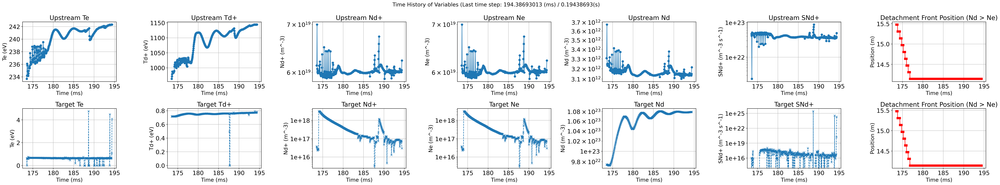

In [71]:
plot_time_history(fixed_density, variables=['Te','Td+','Nd+', 'Ne', 'Nd','SNd+'], track_detachment_front = True)

array([<Axes: xlabel='S$_\\parallel$ (m)', ylabel='Te (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Td+ (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Ne (m^-3)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Nd (m^-3)'>],
      dtype=object)

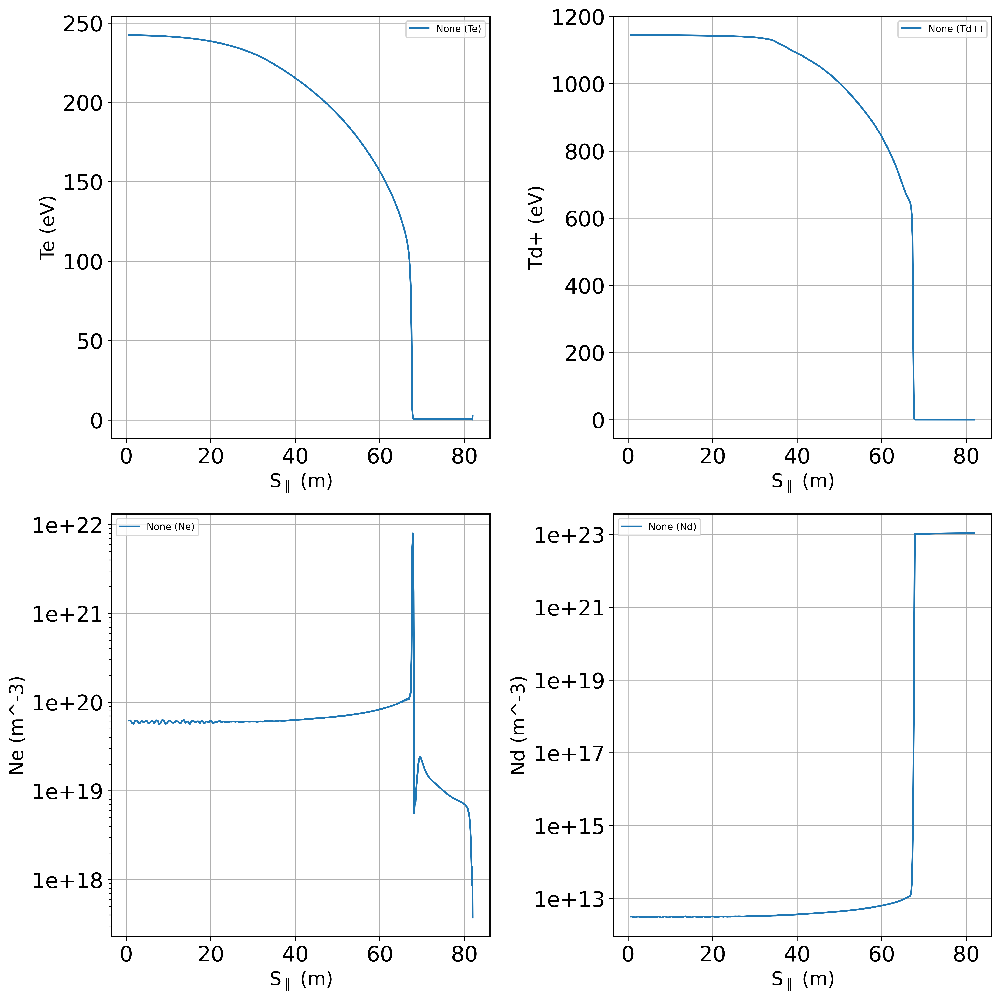

In [72]:
plot_profiles(fixed_density, variables = ['Te', 'Td+', 'Ne', 'Nd'])

array([<Axes: xlabel='S$_\\parallel$ (m)', ylabel='Sd+_feedback (m^-3 s^-1)'>],
      dtype=object)

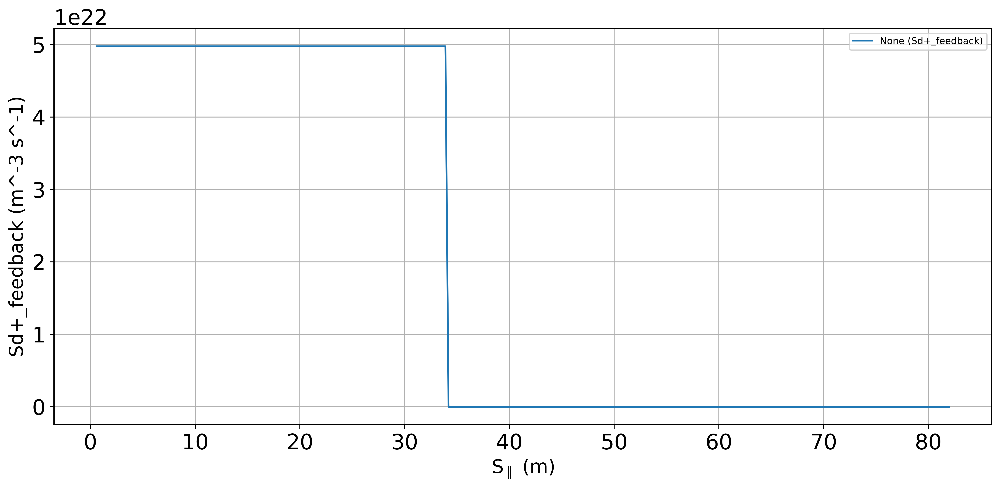

In [70]:
plot_profiles(fixed_density, variables = ['Sd+_feedback'], log_threshold=1e30)

print(fixed_density['Sd+_feedback'])

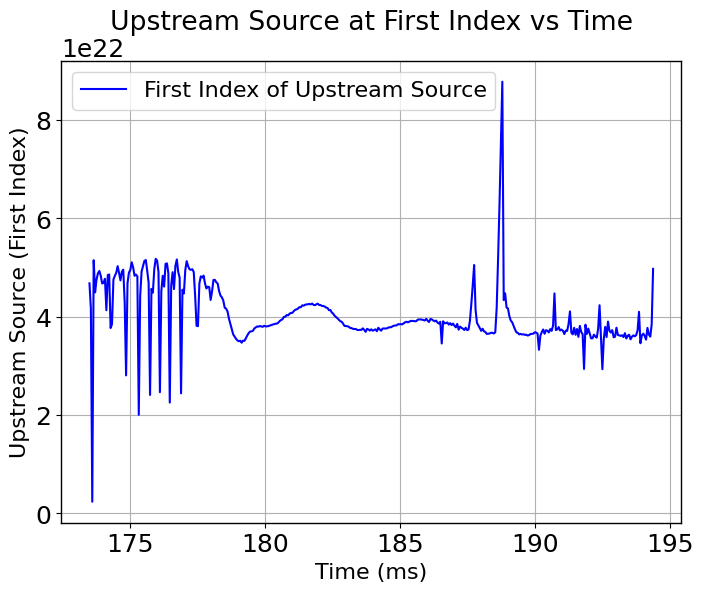

Average value between 190 ms and 195 ms: 3.693996374611421e+22


In [93]:
t = fixed_density['t'].values * 1e3
y = fixed_density['y'].values
# print(t)

upstream_source = fixed_density['Sd+_feedback'].values.reshape(len(t), len(y))

# Assuming upstream_source is defined as described
first_index_source = upstream_source[:, 0]  # Select the first index along the y-axis

# Plot the first index of upstream_source against time
plt.figure(figsize=(8, 6))
plt.plot(t, first_index_source, label="First Index of Upstream Source", color="blue")
plt.xlabel("Time (ms)")
plt.ylabel("Upstream Source (First Index)")
plt.title("Upstream Source at First Index vs Time")
plt.legend()
plt.grid(True)
plt.show()

# Filter the data between 190 ms and 195 ms
mask = (t >= 190) & (t <= 195)
filtered_values = first_index_source[mask]

# print(filtered_values)

# Calculate the average
average_value = filtered_values.mean()
print("Average value between 190 ms and 195 ms:", average_value)



In [73]:
test_density = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-11_week_8/steady_state_fixed_density/case_01_run_longer')

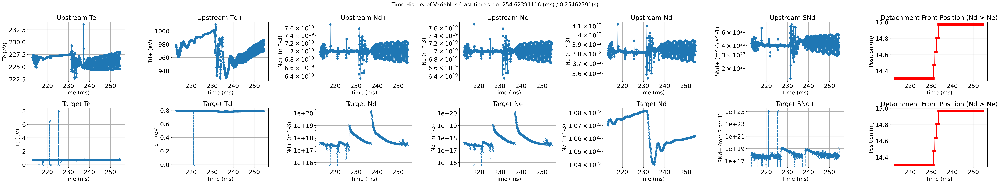

In [74]:
plot_time_history(test_density, variables=['Te','Td+','Nd+', 'Ne', 'Nd','SNd+'], track_detachment_front = True)

array([<Axes: xlabel='S$_\\parallel$ (m)', ylabel='Te (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Td+ (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Ne (m^-3)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Nd (m^-3)'>],
      dtype=object)

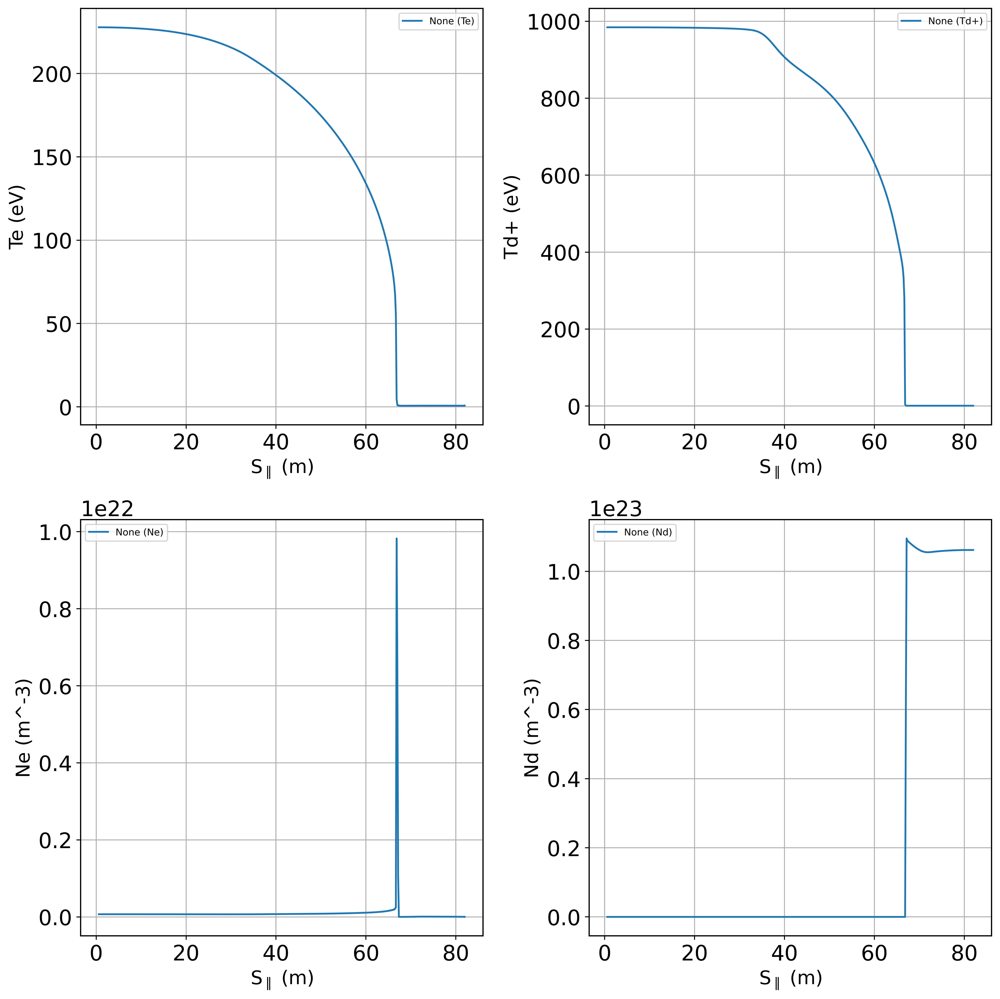

In [77]:
upden_src = 

array([<Axes: xlabel='S$_\\parallel$ (m)', ylabel='Sd+_feedback (m^-3 s^-1)'>],
      dtype=object)

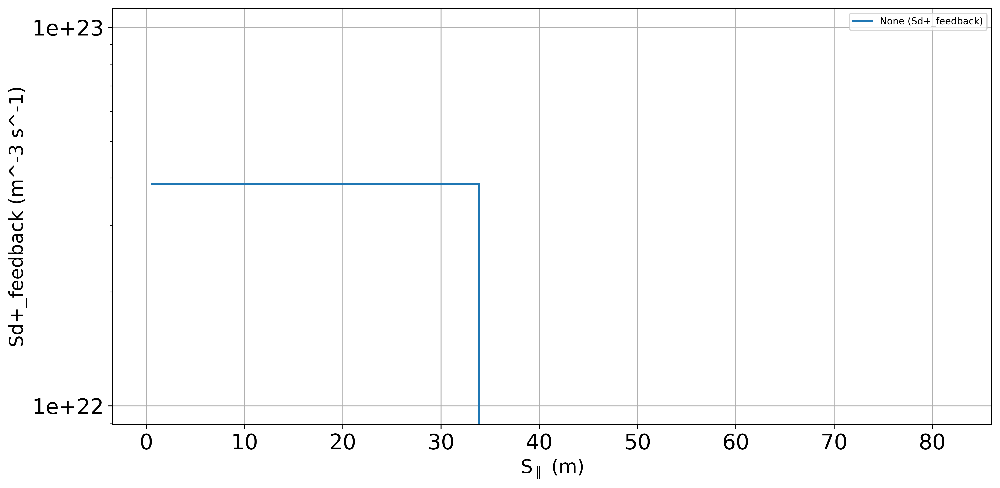

In [76]:
plot_profiles(test_density, variables = ['Sd+_feedback'])

In [94]:
fixed_density_2 = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-11_week_8/steady_state_fixed_density/case_03_02_constant_src')

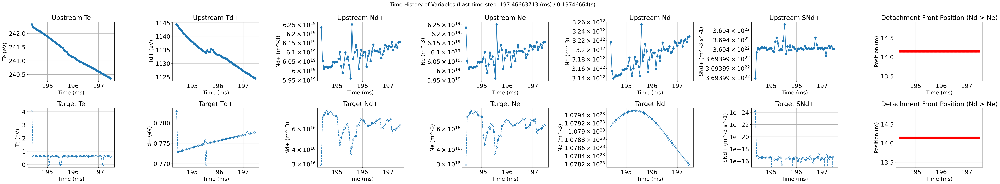

In [95]:
plot_time_history(fixed_density_2, variables=['Te','Td+','Nd+', 'Ne', 'Nd','SNd+'], track_detachment_front = True)

array([<Axes: xlabel='S$_\\parallel$ (m)', ylabel='Te (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Td+ (eV)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Ne (m^-3)'>,
       <Axes: xlabel='S$_\\parallel$ (m)', ylabel='Nd (m^-3)'>],
      dtype=object)

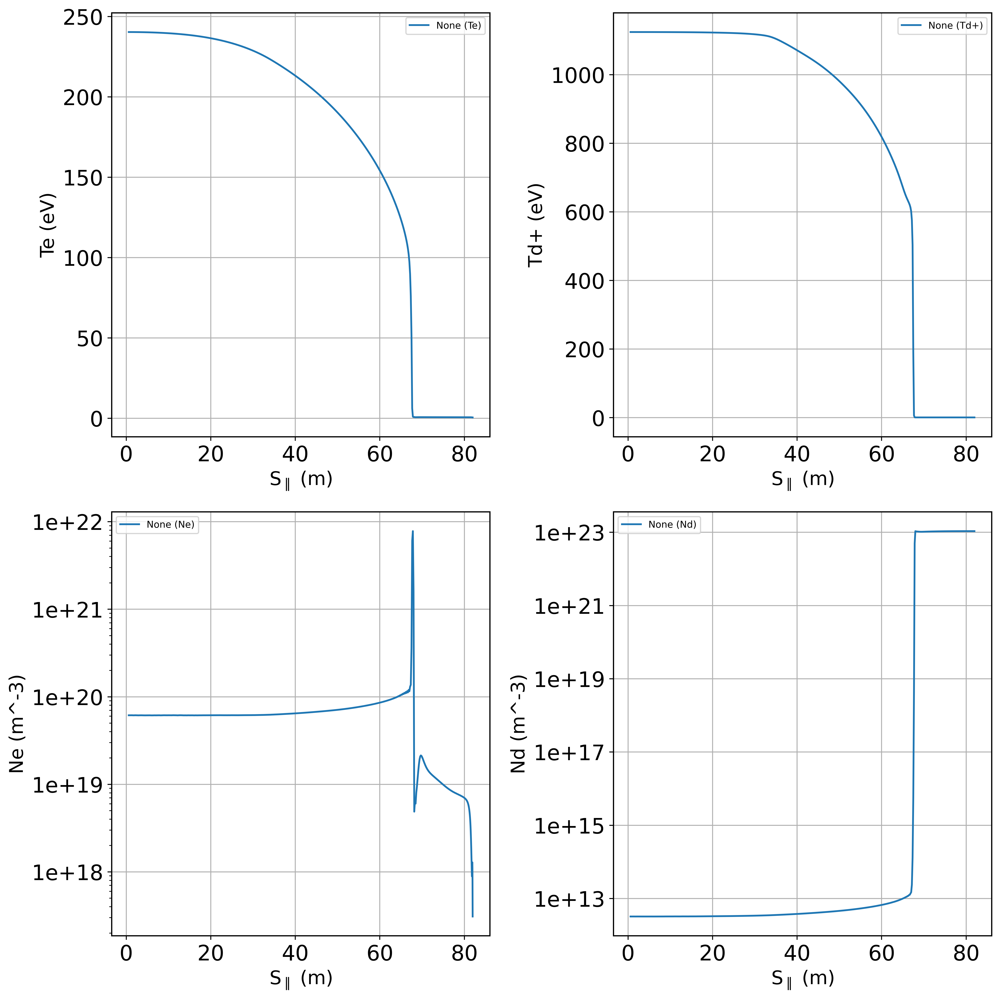

In [96]:
plot_profiles(fixed_density_2, variables = ['Te', 'Td+', 'Td', 'Nd'])

## Fixed density 8e22 pump


In [4]:
e22_pump = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-11_week_8/steady_state_fixed_density/case_04_03_constant_src_reservoir_8e22')

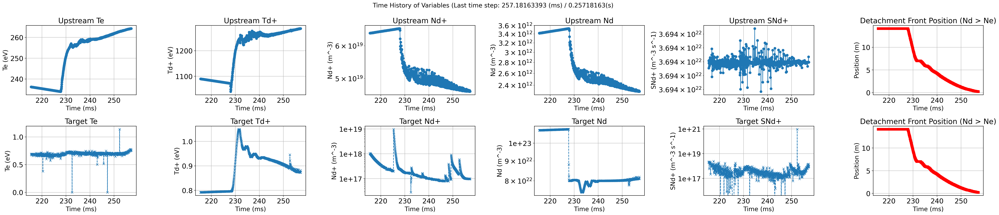

In [19]:
plot_time_history(e22_pump, variables=['Te','Td+','Nd+', 'Nd','SNd+'], track_detachment_front = True)

In [5]:
plot_profiles(e22_pump, variables = ['Te', 'Td+', 'Td', 'Nd'])

In [23]:
neutral_sources = ['Sd_src', 'Sd+_rec','Sd_target_recycle' ]
neutral_sinks = ['Sd_rsv_div_sol', 'Sd+_iz']


neutral_sources = [ 'Sd+_rec','Sd_target_recycle', 'Sd_src']
neutral_sinks = [ 'Sd+_iz',  'Sd_rsv_div_sol']


neutral_sources = [ 'Sd+_rec','Sd_target_recycle', 'Sd_src']
neutral_sinks = [ 'Sd+_iz',  'Sd_rsv_div_sol']

# energy_sources = ['Rneon', 'Rd+_rec', 'Rd+_ex']

particle_sink_source(e22_pump, sources = [], sinks = ['Sd_rsv_div_sol'], log_scale = True)

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 41:
  #000: H5Dio.c line 179 in H5Dread(): can't read data
    major: Dataset
    minor: Read failed
  #001: H5VLcallback.c line 2011 in H5VL_dataset_read(): dataset read failed
    major: Virtual Object Layer
    minor: Read failed
  #002: H5VLcallback.c line 1978 in H5VL__dataset_read(): dataset read failed
    major: Virtual Object Layer
    minor: Read failed
  #003: H5VLnative_dataset.c line 166 in H5VL__native_dataset_read(): can't read data
    major: Dataset
    minor: Read failed
  #004: H5Dio.c line 545 in H5D__read(): can't read data
    major: Dataset
    minor: Read failed
  #005: H5Dchunk.c line 2541 in H5D__chunk_read(): error looking up chunk address
    major: Dataset
    minor: Can't get value
  #006: H5Dchunk.c line 3262 in H5D__chunk_lookup(): can't query chunk address
    major: Dataset
    minor: Can't get value
  #007: H5Dbtree.c line 1008 in H5D__btree_idx_get_addr(): can't get chunk info
    major: Dataset
    m

RuntimeError: NetCDF: HDF error

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 42:
  #000: H5Dio.c line 179 in H5Dread(): can't read data
    major: Dataset
    minor: Read failed
  #001: H5VLcallback.c line 2011 in H5VL_dataset_read(): dataset read failed
    major: Virtual Object Layer
    minor: Read failed
  #002: H5VLcallback.c line 1978 in H5VL__dataset_read(): dataset read failed
    major: Virtual Object Layer
    minor: Read failed
  #003: H5VLnative_dataset.c line 166 in H5VL__native_dataset_read(): can't read data
    major: Dataset
    minor: Read failed
  #004: H5Dio.c line 545 in H5D__read(): can't read data
    major: Dataset
    minor: Read failed
  #005: H5Dchunk.c line 2541 in H5D__chunk_read(): error looking up chunk address
    major: Dataset
    minor: Can't get value
  #006: H5Dchunk.c line 3262 in H5D__chunk_lookup(): can't query chunk address
    major: Dataset
    minor: Can't get value
  #007: H5Dbtree.c line 1008 in H5D__btree_idx_get_addr(): can't get chunk info
    major: Dataset
    m

# Rise time

In [6]:
rise = xh.open('/users/jlb647/scratch/simulation_program/hermes-3_sim/simulation_dir/2024-11_week_8/rise_time/case_01')

In [26]:

plot_time_history(rise, variables = ['Te', 'Nd+', 'Nd', 'SPe'], track_detachment_front=True)

In [59]:
upsream_source = []
target_heat_flux = []

print(rise['kappa_par_e'])
print(rise['kappa_par_e'].shape)


for ind, t in enumerate(rise['t']):
    print(f"Time step {ind}: {t}")
    q_flux = spitzer_electron_simple(rise.isel(t=ind))
    src = np.ravel(rise['SPe'].isel(t=ind))
    print(f"q_flux: {q_flux}")
    target_heat_flux.append(q_flux[-1])
    upsream_source.append(src[0])

plt.plot(rise['t'], upsream_source, label='Upstream Heat Source')
plt.plot(rise['t'], target_heat_flux, label='Target Heat Flux')


<xarray.DataArray 'kappa_par_e' (t: 1201, x: 1, y: 400, z: 1)>
dask.array<mul, shape=(1201, 1, 400, 1), dtype=float64, chunksize=(1201, 1, 10, 1), chunktype=numpy.ndarray>
Coordinates:
    dx       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
    dy       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
    dz       (x, y) float64 dask.array<chunksize=(1, 10), meta=np.ndarray>
  * t        (t) float64 0.03174 0.03179 0.03184 ... 0.09427 0.09432 0.09437
  * x        (x) int64 0
  * y        (y) float64 0.121 0.3627 0.6038 0.8443 ... 50.95 50.97 50.98 50.99
  * z        (z) float64 3.142
Attributes:
    current_time_index:  1201
    cell_location:       CELL_CENTRE
    conversion:          160.21766340000002
    direction_y:         Standard
    direction_z:         Standard
    long_name:           e heat conduction coefficient
    source:              evolve_pressure
    species:             e
    time_dimension:      t
    units:               W / m / eV


print(rise['z'])
print(rise['z'].values)


In [7]:
def spitzer_electron_simple(dataframe):
    """
    Calculate Spitzer-Harm with hermes-3 conductivity output.
    """
    x = dataframe['y']
    Te = dataframe['Te']
    kappa_e = dataframe['kappa_par_e']
    grad_T = np.gradient(Te, x)
    q = -kappa_e * grad_T

    return q

def replace_guards(var):
    """
    This in-place replaces the points in the guard cells with the points 
    on the boundary.
    """
    var = var[1:-1]  # Strip the edge guard cells

    var[0] = 0.5 * (var[0] + var[1])
    var[-1] = 0.5 * (var[-1] + var[-2])
    
    return var

In [8]:
y = rise['y'].values[1:-1]
kappa = rise['kappa_par_e'].values.reshape(1201,400)
Te = rise['Te'].values.reshape(1201,400)

grad_Te = np.gradient(Te, axis=1)

398


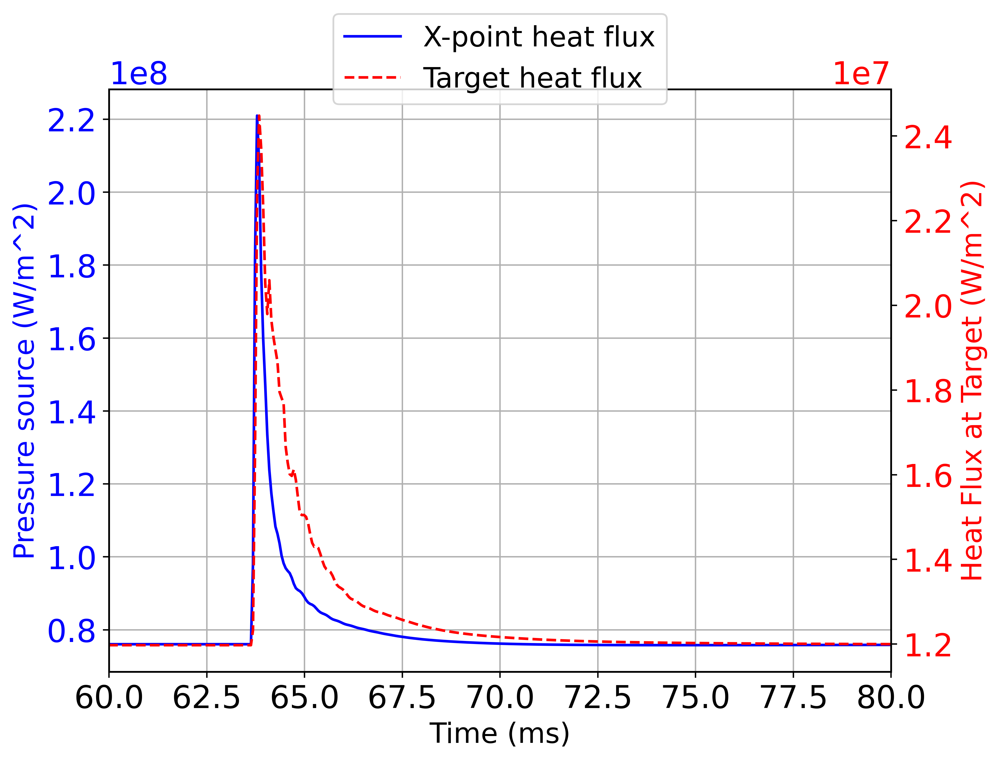

In [9]:
t = rise['t'].values * 1e3
src = rise['Pe_src'].values.reshape(1201,400)


src_upstream = src[:,0]

q = -kappa * grad_Te

q = np.apply_along_axis(replace_guards, 1, q)

print(len(q[1]))

target_flux = []
upstream_flux = []
xpoint_flux = []
x_point_index = np.argmin(np.abs(y - 34))


for indx,i in enumerate(t):
    target_flux.append(q[indx][-1])
    upstream_flux.append(q[indx][0])
    xpoint_flux.append(q[indx][x_point_index])
    # print(i)
# print(target_flux)
# plt.plot(y, q[-1], label='Heat Flux at last time slice')

fig,ax = plt.subplots(1,1,figsize=(8,6),dpi=500)

ax2 = ax.twinx()


# ax2.plot(t, upstream_flux, label='Upstream Heat flux', color='orange')
ax.plot(t, xpoint_flux, label='X-point heat flux', color='blue')
# ax.plot(t, src_upstream, label='Upstream Heat Source', color='blue')
ax2.plot(t, target_flux, label='Target heat flux', color='red', linestyle='--')
ax2.grid(False)
fig.legend(loc = 'upper center')
ax.set_xlabel('Time (ms)')
ax.set_ylabel('Pressure source (W/m^2)', color = 'blue')
ax2.set_ylabel('Heat Flux at Target (W/m^2)', color='red')
# ax.set_yscale('log')
# ax2.set_yscale('log')
ax.set_xlim(60, 80)
ax2.tick_params(axis='y', labelcolor='red')
ax.tick_params(axis='y', labelcolor='blue')





Upstream Times (ms): {'100%': 63.73427542627614, '75%': 63.8735649602343, '50%': 64.03192465740099}
Target Times (ms): {'100%': 63.83867227382123, '75%': 64.33075128974893, '50%': 69.14247150886072}
Time between 100% decay levels (μs): 104.3968475450896


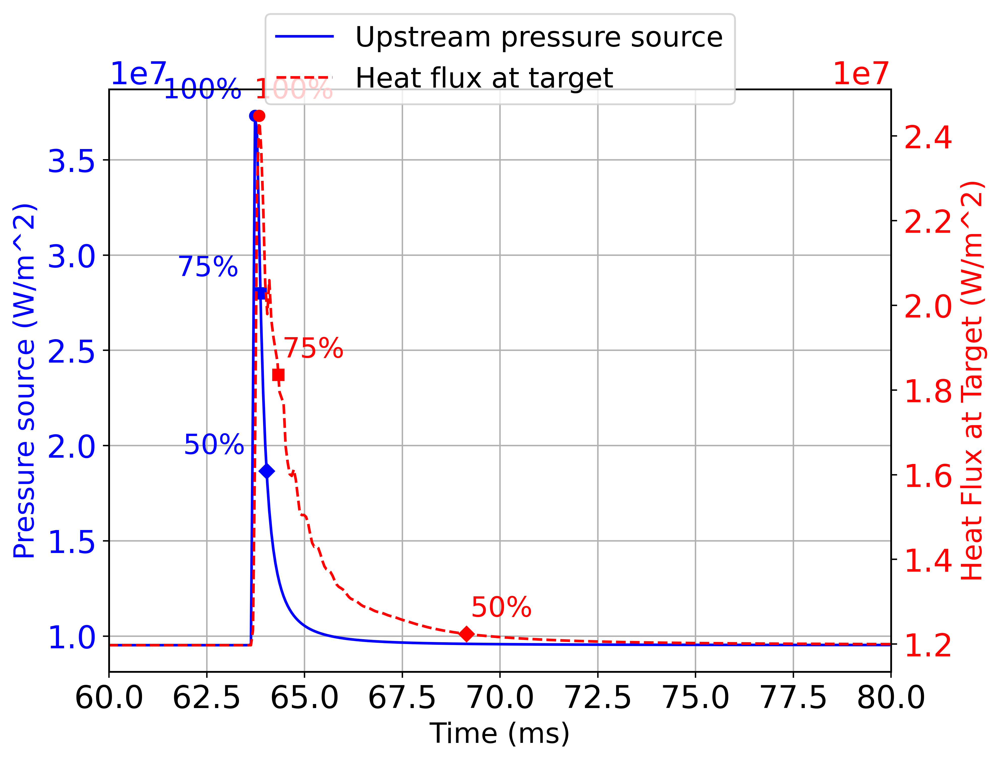

In [17]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming t, src_upstream, target_flux are already defined as in your code

# Find peaks
peak_src_upstream = np.max(src_upstream)
peak_target_flux = np.max(target_flux)

# Function to interpolate to find exact crossing times
def find_time_to_fraction(signal, time_array, peak_value, fraction):
    target_value = peak_value * fraction
    peak_index = np.argmax(signal)
    
    # Search for the first crossing below the target value after the peak
    for i in range(peak_index, len(signal) - 1):
        if signal[i] >= target_value and signal[i + 1] < target_value:
            # Linear interpolation to estimate the exact crossing time
            slope = (signal[i + 1] - signal[i]) / (time_array[i + 1] - time_array[i])
            intercept = signal[i] - slope * time_array[i]
            crossing_time = (target_value - intercept) / slope
            return crossing_time
    return None  # If no crossing is found

# Calculate times for 100%, 75%, and 50% of the peak for each curve
fractions = [1.0, 0.75, 0.5]
times_src_upstream = {f"{int(fraction * 100)}%": find_time_to_fraction(src_upstream, t, peak_src_upstream, fraction) for fraction in fractions}
times_target_flux = {f"{int(fraction * 100)}%": find_time_to_fraction(target_flux, t, peak_target_flux, fraction) for fraction in fractions}

# Define markers for different thresholds
markers = {"100%": "o", "75%": "s", "50%": "D"}  # Circle, Square, Diamond

# Plot the original data
fig, ax = plt.subplots(1, 1, figsize=(8, 6), dpi=500)
ax2 = ax.twinx()

ax.plot(t, src_upstream, label="Upstream pressure source", color="blue")
ax2.plot(t, target_flux, label="Heat flux at target", color="red", linestyle="--")
ax2.grid(False)

# Add vertical lines and markers with annotations for 100%, 75%, and 50% decay points
for fraction, time in times_src_upstream.items():
    if time:
        value = peak_src_upstream * float(fraction[:-1]) / 100
        ax.plot(time, value, marker=markers[fraction], color="blue")
        ax.annotate(f"{fraction}", (time, value), textcoords="offset points", xytext=(-30, 10), ha='center', color="blue")

for fraction, time in times_target_flux.items():
    if time:
        value = peak_target_flux * float(fraction[:-1]) / 100
        ax2.plot(time, value, marker=markers[fraction], color="red")
        ax2.annotate(f"{fraction}", (time, value), textcoords="offset points", xytext=(20, 10), ha='center', color="red")

# Print times for verification
print("Upstream Times (ms):", times_src_upstream)
print("Target Times (ms):", times_target_flux)

# Set labels and legend
fig.legend(loc="upper center")
ax.set_xlabel("Time (ms)")
ax.set_ylabel("Pressure source (W/m^2)", color="blue")
ax2.set_ylabel("Heat Flux at Target (W/m^2)", color="red")
ax.set_xlim(60, 80)
ax2.tick_params(axis="y", labelcolor="red")
ax.tick_params(axis="y", labelcolor="blue")

# Calculate time difference between 100% decay levels
time_difference = (times_target_flux['100%'] - times_src_upstream['100%']) * 1e3  # convert to microseconds
print(f'Time between 100% decay levels (μs): {time_difference}')

plt.show()


In [64]:
(104.4/250) * 100 

41.760000000000005